In [1]:
import pandas as pd
import numpy as np
import os

from sklearn.preprocessing import LabelEncoder, StandardScaler, MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.impute import KNNImputer
import umap

from matplotlib import pyplot as plt
# do the inline thing
%matplotlib inline

# import seaborn as sns
import altair as alt

from lcfunctions import download_lasair_lc, display_lightcurve
from lcfunctions import lasair_clean, load_lasair_lc

from outlier import outlier_iqr, outlier_bounds, log_transform


/Users/aridmist/opt/anaconda3/envs/umap/lib/python3.10/site-packages/umap/distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/Users/aridmist/opt/anaconda3/envs/umap/lib/python3.10/site-packages/umap/distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/Users/aridmist/opt/anaconda3/envs/umap/lib/python3.10/site-

### Dataset and preprocessing

In [3]:
cvlistdate = '21032023'
lightcurvesdate = '08102023'
label_scheme = 'labels_1'

pd.options.display.max_columns = None

dataset = pd.read_csv(f'../processed_data/dataset_{cvlistdate}allfeatures_inc_labels{lightcurvesdate}.csv', low_memory=False)
dataset = dataset[dataset[label_scheme].notna()].reset_index(drop=True)
# drop rows with no Gaia data
# dataset = dataset[dataset['ra_error'].notna()].reset_index(drop=True)
# dataset = dataset[dataset['absmag_g'].notna()].reset_index(drop=True)

# Handle outliers
bounds = {'Period_fit_g':[0,1], 'Period_fit_r':[0,1]}
bounds2 = {'pwr_max_g':[0,1], 'pwr_max_r':[0,1],
           'freq_pwr_max_g':[0,1], 'freq_pwr_max_r':[0,1]}
bounds3 = {'distance':[0,np.inf]}
dataset = outlier_bounds(dataset, bounds)
dataset = outlier_bounds(dataset, bounds2)
dataset = outlier_bounds(dataset, bounds3)

iqr_cols = ['LinearTrend_g','LinearTrend_r']
iqr_cols2 = ['clr_mean','clr_median', 'clr_bright','clr_faint']
iqr_cols3 = ['astrometric_sigma5d_max']
iqr_cols4 = ['bp_rp','bp_g','g_rp']
iqr_cols5 = ['absmag_g','absmag_bp','absmag_rp']
dataset = outlier_iqr(dataset, iqr_cols, iqr_threshold=5)
dataset = outlier_iqr(dataset, iqr_cols2, iqr_threshold=2)
dataset = outlier_iqr(dataset, iqr_cols3, iqr_threshold=10)
dataset = outlier_iqr(dataset, iqr_cols4, iqr_threshold=2)
dataset = outlier_iqr(dataset, iqr_cols5, iqr_threshold=3)

# Log transform
log_cols = ['Autocor_length_g','CAR_mean_g','CAR_sigma_g','Eta_e_g',
            'Freq1_harmonics_amplitude_0_g','Freq1_harmonics_amplitude_1_g',
            'Freq1_harmonics_amplitude_2_g','Freq1_harmonics_amplitude_3_g',
            'Freq2_harmonics_amplitude_0_g','Freq2_harmonics_amplitude_1_g',
            'Freq2_harmonics_amplitude_2_g','Freq2_harmonics_amplitude_3_g',
            'Freq3_harmonics_amplitude_0_g','Freq3_harmonics_amplitude_1_g',
            'Freq3_harmonics_amplitude_2_g','Freq3_harmonics_amplitude_3_g',
            'MaxSlope_g','PeriodLS_g','SlottedA_length_g',
            'Autocor_length_r','CAR_mean_r','CAR_sigma_r','Eta_e_r',
            'Freq1_harmonics_amplitude_0_r','Freq1_harmonics_amplitude_1_r',
            'Freq1_harmonics_amplitude_2_r','Freq1_harmonics_amplitude_3_r',
            'Freq2_harmonics_amplitude_0_r','Freq2_harmonics_amplitude_1_r',
            'Freq2_harmonics_amplitude_2_r','Freq2_harmonics_amplitude_3_r',
            'Freq3_harmonics_amplitude_0_r','Freq3_harmonics_amplitude_1_r',
            'Freq3_harmonics_amplitude_2_r','Freq3_harmonics_amplitude_3_r',
            'MaxSlope_r','PeriodLS_r','SlottedA_length_r'
            ]

log_cols2 = ['freq_pwr_max_g','pwr_maxovermean_g',
             'npeaks_pt5to1_g','rrate_pt5to1_g','drate_pt5to1_g', 
             'npeaks_1to2_g','rrate_1to2_g','drate_1to2_g',
             'npeaks_2to5_g','rrate_2to5_g','drate_2to5_g',
             'npeaks_above5_g','rrate_above5_g','drate_above5_g',
             'rollstd_ratio_t20s10_g','rollstd_ratio_t10s5_g',
             'pnts_leq_rollMedWin20-1mag_g','pnts_leq_rollMedWin20-2mag_g','pnts_leq_rollMedWin20-5mag_g',
             'pnts_geq_rollMedWin20+1mag_g','pnts_geq_rollMedWin20+2mag_g','pnts_geq_rollMedWin20+3mag_g',
             'pnts_leq_median-1mag_g','pnts_leq_median-2mag_g','pnts_leq_median-5mag_g',
             'pnts_geq_median+1mag_g','pnts_geq_median+2mag_g','pnts_geq_median+3mag_g',
             'freq_pwr_max_r','pwr_maxovermean_r',
             'npeaks_pt5to1_r','rrate_pt5to1_r','drate_pt5to1_r',
             'npeaks_1to2_r','rrate_1to2_r','drate_1to2_r',
             'npeaks_2to5_r','rrate_2to5_r','drate_2to5_r',
             'npeaks_above5_r','rrate_above5_r','drate_above5_r',
             'rollstd_ratio_t20s10_r','rollstd_ratio_t10s5_r',
             'pnts_leq_rollMedWin20-1mag_r','pnts_leq_rollMedWin20-2mag_r','pnts_leq_rollMedWin20-5mag_r',
             'pnts_geq_rollMedWin20+1mag_r','pnts_geq_rollMedWin20+2mag_r','pnts_geq_rollMedWin20+3mag_r',
             'pnts_leq_median-1mag_r','pnts_leq_median-2mag_r','pnts_leq_median-5mag_r',
             'pnts_geq_median+1mag_r','pnts_geq_median+2mag_r','pnts_geq_median+3mag_r'
             ]

log_cols3 = ['ra_error','dec_error',
            'parallax_error',
            'pm',
            'pmra_error',
            'pmdec_error',
            'phot_g_mean_flux',
            'phot_g_mean_flux_error',
            'phot_bp_mean_flux',
            'phot_bp_mean_flux_error',
            'phot_rp_mean_flux',
            'phot_rp_mean_flux_error',
            'distance'
            ]

dataset = log_transform(dataset, log_cols)
dataset = log_transform(dataset, log_cols2)
dataset = log_transform(dataset, log_cols3)

# Drop Gaia features
dataset = dataset.iloc[:,:-34]

# Filter dataset
dataset_pts_threshold = dataset[(dataset['n_obs_g']>=20) | (dataset['n_obs_r']>=20)].reset_index(drop=True)
dataset_timespan_threshold = dataset[dataset['temporal_baseline_g']>=365].reset_index(drop=True)

# Dataset going forward
dataset_final = dataset_pts_threshold

print(dataset_final[label_scheme].value_counts())

# Features and labels.
X = dataset_final.iloc[:,14:]
X_cols = X.columns.tolist()
y_names = dataset_final[label_scheme]

# pd.options.display.max_rows = 10
# print(X.isnull().sum())

dataset_final.shape


labels_1
dwarf_nova_SU_UMa    378
dwarf_nova_Z_Cam     168
nova_like            138
nova_like_VY_Scl     117
dwarf_nova_U_Gem     115
polar                110
int_polar             49
AMCVn                 35
dwarf_nova_WZ_Sge     32
nova                  27
dwarf_nova_ER_UMa     25
Name: count, dtype: int64


(1194, 236)

In [4]:
enc = LabelEncoder().fit(y_names)
y = enc.transform(y_names)

# Train, test, split.
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, stratify=y, random_state=1)

# Scale data.
scaler = StandardScaler()
X_train_proc = scaler.fit_transform(X_train)
X_test_proc = scaler.transform(X_test)
scaler2 = StandardScaler()
X_proc = scaler2.fit_transform(X)

# Impute missing values with knn imputer.
imputer = KNNImputer(n_neighbors=5)
X_train_proc = imputer.fit_transform(X_train_proc)
X_test_proc = imputer.transform(X_test_proc)
imputer2 = KNNImputer(n_neighbors=5)
X_proc = imputer2.fit_transform(X_proc)

# # MinMaxScaler
# scaler3 = MinMaxScaler()
# X_train_proc = scaler3.fit_transform(X_train_proc)
# X_test_proc = scaler3.transform(X_test_proc)
# scaler4 = MinMaxScaler()
# X_proc = scaler4.fit_transform(X_proc)


### Perform UMAP

In [55]:
# Obtain model
n_neighbors = 15
min_dist = 0.1
n_epochs = 100000
learning_rate = 1
metric = 'euclidean'

reducer = umap.UMAP(n_neighbors=n_neighbors,
                    min_dist=min_dist,
                    n_components=2,
                    n_epochs=n_epochs,
                    learning_rate=learning_rate,
                    metric=metric,
                    random_state=1
                    )
X_train_umap = reducer.fit_transform(X_train_proc)
X_test_umap = reducer.transform(X_test_proc)

reducer2 = umap.UMAP(n_neighbors=n_neighbors,
                     min_dist=min_dist,
                     n_components=2,
                     n_epochs=n_epochs,
                     learning_rate=learning_rate,
                     metric=metric,
                     random_state=1)
X_umap = reducer2.fit_transform(X_proc)

KeyboardInterrupt: 

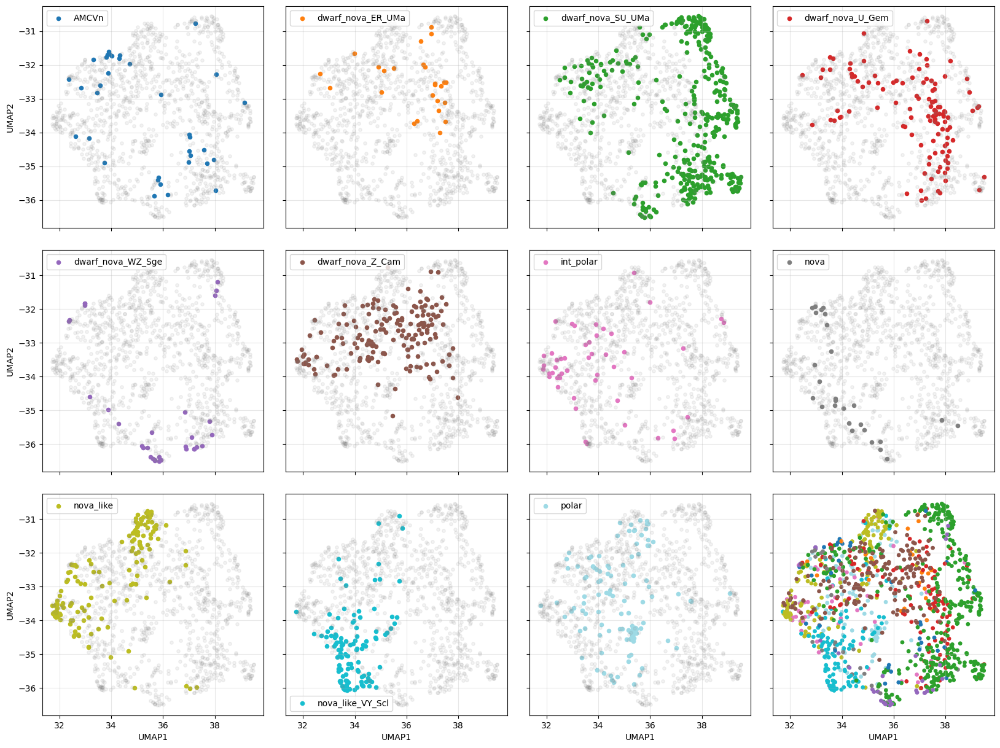

/Users/aridmist/opt/anaconda3/envs/umap/lib/python3.10/site-packages/altair/utils/core.py:410: FutureWarning:

the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.

/Users/aridmist/opt/anaconda3/envs/umap/lib/python3.10/site-packages/altair/utils/core.py:410: FutureWarning:

the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.



alt.Chart(...)

In [54]:
# Plot the full dataset using altair
df_umap_X = pd.DataFrame(X_proc, columns=X_cols)
# Re-scale features using min-max scaler
scaler3 = MinMaxScaler()
df_umap_X[X_cols] = scaler3.fit_transform(df_umap_X[X_cols])
df_umap_X = pd.concat([df_umap_X, 
                       pd.Series(dataset_final.index, name='index'), 
                       dataset_final['oid_ztf'], 
                       dataset_final['type_aavso'],
                       pd.Series(X_umap[:,0], name='UMAP1'),
                       pd.Series(X_umap[:,1], name='UMAP2'),
                       pd.Series(y_names, name='label')
                       ], axis=1)

selection = alt.selection_point(fields=['label'], bind='legend')

projection_full = alt.Chart(df_umap_X).mark_square(size=30).encode(
    x=alt.X('UMAP1', scale=alt.Scale(zero=False)),
    y=alt.Y('UMAP2', scale=alt.Scale(zero=False)),
    color=alt.Color(shorthand='label', title='Class',
                    # Select a colour scheme for the classes where the colours are distinct, and more than 11 classes
                    scale=alt.Scale(domain=np.unique(y_names).tolist(),
                                    scheme='category20',
                                    # range=clr_range
                                    )),
    tooltip=['label', 'index','oid_ztf', 'type_aavso'],
    opacity=alt.condition(selection, alt.value(0.8), alt.value(0.1))
).add_params(selection).interactive()

projection_full.title = 'UMAP Projection of Full Dataset'


# Plot training set using altair
df_umap_train = pd.DataFrame(X_train_proc, columns=X_cols)
df_umap_train['UMAP1'] = X_train_umap[:,0]
df_umap_train['UMAP2'] = X_train_umap[:,1]
df_umap_train['label'] = enc.inverse_transform(y_train)

projection_train = alt.Chart(df_umap_train).mark_circle(size=50).encode(
    x=alt.X('UMAP1', scale=alt.Scale(zero=False)),
    y=alt.Y('UMAP2', scale=alt.Scale(zero=False)),
    color='label',
    tooltip=['label'],
).interactive()

projection_train.title = 'UMAP Projection of Training Set'

# Plot projection of test set using altair
df_umap_test = pd.DataFrame(X_test_proc, columns=X_cols)
df_umap_test['UMAP1'] = X_test_umap[:,0]
df_umap_test['UMAP2'] = X_test_umap[:,1]
df_umap_test['label'] = enc.inverse_transform(y_test)

projection_test = alt.Chart(df_umap_test).mark_circle(size=50).encode(
    x=alt.X('UMAP1', scale=alt.Scale(zero=False)),
    y=alt.Y('UMAP2', scale=alt.Scale(zero=False)),
    color='label',
    tooltip=['label'],
).interactive()

projection_test.title = 'UMAP Projection of Test Set'


# Use matplotlib subplots to plot one class versus the rest for each of the classes, where the last subplot is all the classes.
fig, ax = plt.subplots(3,4, figsize=(20,15), sharex=True, sharey=True)
ax = ax.flatten()
# use the cmap tab20 for the first 11 classes
c = plt.cm.tab20(np.linspace(0,1,11))
# can you perform the above as a list of colours from tab20?

for i in range(11):
    # use the color keyword argument to set the colour of the points instead of c
    ax[i].scatter(X_umap[y==i,0], X_umap[y==i,1], label=enc.inverse_transform([i])[0], s=20, color=c[i])
    ax[i].scatter(X_umap[y!=i,0], X_umap[y!=i,1], c='grey', s=15, alpha=0.1)
    ax[i].grid(alpha=0.3)
    if i in [0,4,8]:
        ax[i].set_ylabel(f'UMAP2')
    if i in [8,9,10,11]:
        ax[i].set_xlabel(f'UMAP1')
    ax[i].legend()
# Use the class colours for the last subplot
ax[11].scatter(X_umap[:,0], X_umap[:,1], s=15, alpha=1, c=y, cmap='tab20')
ax[11].set_xlabel(f'UMAP1')
ax[11].grid(alpha=0.3)
# reduce the gaps between subplots
plt.subplots_adjust(hspace=0.1, wspace=0.1)
# plt.tight_layout()
plt.show()


projection_full #| projection_train | projection_test



### Feature Maps

In [43]:


def plot_factor_map(df_map, feature,fig_size=(150,150),node_size=1):
    #df_map['size']=df_map['size']*node_size
    return alt.Chart(df_map).mark_square().encode(
        x=alt.X('UMAP1',axis=None, scale=alt.Scale(zero=False)),
        y=alt.Y('UMAP2',axis=None, scale=alt.Scale(zero=False)),
        color=alt.Color(f'{feature}:Q',
                        scale=alt.Scale(scheme='turbo')),
        size=alt.value(20),
        tooltip=[f'{feature}:Q','index','oid_ztf','label','type_aavso'],
        #opacity='density'
    ).properties(title=[feature[0:17], feature[17:34]], width=fig_size[0], height=fig_size[1])


varnames = X_cols[0:30]

# Plot individual features along with histogram
# varnames = ['clr_mean']
# dataset_final[varnames].hist(bins=100)

var = 0

# %%
chart = alt.vconcat()
new_line = '\n'
for rr in range(100):
    row = alt.hconcat()
    for cc in range(5):
        if var<len(varnames):
            row |= plot_factor_map(
                df_umap_X, 
                varnames[var])
            var = var + 1
    chart &= row

chart





/Users/aridmist/opt/anaconda3/envs/umap/lib/python3.10/site-packages/altair/utils/core.py:410: FutureWarning:

the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.

/Users/aridmist/opt/anaconda3/envs/umap/lib/python3.10/site-packages/altair/utils/core.py:410: FutureWarning:

the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.



alt.VConcatChart(...)

### Display light curve of object

In [30]:
# Display lasair difference magnitude and apparent magnitude light curves.
index = 736
feature_focused = 'clr_mean'
objects = [dataset_final.iloc[index,:]['oid_ztf']]
manual_label = dataset_final.iloc[index,:]['labels_1']
oid_aavso = dataset_final.iloc[index,:]['oid_aavso']
type_aavso = dataset_final.iloc[index,:]['type_aavso']
value = dataset_final.iloc[index,:][feature_focused]

print(objects)
print(manual_label, oid_aavso, type_aavso, value)
date = '08102023'

# Apply errorbars
error = False

if error == True:
        errColalerce1 = 'sigmapsf'
        errColalerce2 = 'sigmapsf_corr_revised'
        errCollasair1 = 'sigmapsf'
        errCollasair2 = 'dc_sigmag'
else:
    errColalerce1 = None
    errColalerce2 = None
    errCollasair1 = None
    errCollasair2 = None

for object in objects:
    try:
        lc_lasair = load_lasair_lc(object, path=f'../lightcurves_dataset/lasair_{date}')
    except:
        # Create a folder within path for LCs if one does not exist
        if not os.path.exists(f'../lightcurves_dataset/lasair_non_dataset/cache'):
            os.makedirs(f'../lightcurves_dataset/lasair_non_dataset/cache')
        print('Not in dataset')
        download_lasair_lc([object], folderpath=f'../lightcurves_dataset/lasair_non_dataset', cache=f'../lightcurves_dataset/lasair_non_dataset/cache')
        lc_lasair = load_lasair_lc(object, path=f'../lightcurves_dataset/lasair_non_dataset')

    lc_lasair_appmag = lasair_clean(lc_lasair, limit=25, magerrlim=1)

    # print('Lasair difference magnitude')
    # display_lightcurve(lc_lasair,x='jd',y='magpsf',errorCol=errCollasair1)
    print('Lasair apparent magnitude')
    display_lightcurve(lc_lasair_appmag,x='jd',y='dc_mag',errorCol=errCollasair2)

['ZTF18aazmwvg']
dwarf_nova_SU_UMa HO Del UGSU 0.086395587143766
Lasair apparent magnitude
